In [215]:
import textwrap

import pandas as pd
import json
import os
from sentence_transformers import SentenceTransformer
import hdbscan
import matplotlib.pyplot as plt
import umap
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.tokenize import word_tokenize
import pymorphy2
import requests
import plotly.graph_objects as go

# Description

The notebook is provided clusterization and topic analysis of set of posts from telegram channel [@Hikikomori_on](https://t.me/hikikomori_on).

The following code is strongly relied on tutorial [Topic Modeling with BERT](https://towardsdatascience.com/topic-modeling-with-bert-779f7db187e6).

## Data Loading

In [ ]:
DATA_DIR = '../../Hikki_text'
FILENAME = 'result.json'

In [ ]:
with open(os.path.join(DATA_DIR, FILENAME), 'r', encoding = 'utf-8') as f:
    data_json = json.load(f)

In [ ]:
data_df = pd.DataFrame(data_json["messages"])

In [ ]:
# Add length of posts for further filtering
data_df["text_length"] = data_df["text"].apply(len)

In [ ]:
# Check size of raw data
data_df.info()

In [ ]:
# Take a look at data samples
data_df.head()

In [ ]:
# Filter data with only texts of posts larger than 100
data_df_no_empty_messages = data_df[data_df["text_length"]>100].reset_index()

In [ ]:
# Check final size of dataset
data_df_no_empty_messages.info()

In [ ]:
data_df_no_empty_messages.head()

## Get Text Embeddings

[SentenceTransformers](https://www.sbert.net/index.html) - transformers trained to get embeddings for sentences and documents.
The model is trained to solve semantic similarity task


In [ ]:
# Load pretrained weights for light-weight multilingual model

model = SentenceTransformer('distiluse-base-multilingual-cased-v1')

In [ ]:
# Encode posts to vectors
embeddings = model.encode(data_df_no_empty_messages["text"], show_progress_bar=True)

## Clusterize text

First of all we'll reduce the dimensionality of embeddings to speed up the clusterization process and to visualize obtained clusters, we'll use [UMAP](https://umap-learn.readthedocs.io/en/latest/) for it.

The clusterisation is made with [HDBSCAN](https://hdbscan.readthedocs.io/en/latest/index.html) as it can deal with clusters with different densities.


In [126]:
umap_embeddings = umap.UMAP(n_neighbors=15,
                            n_components=5,
                            metric='cosine').fit_transform(embeddings)

In [157]:
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',
                          cluster_selection_method='eom').fit(umap_embeddings)

In [158]:
umap_data = umap.UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = cluster.labels_
result["data_text"] = data_df_no_empty_messages["text"].values

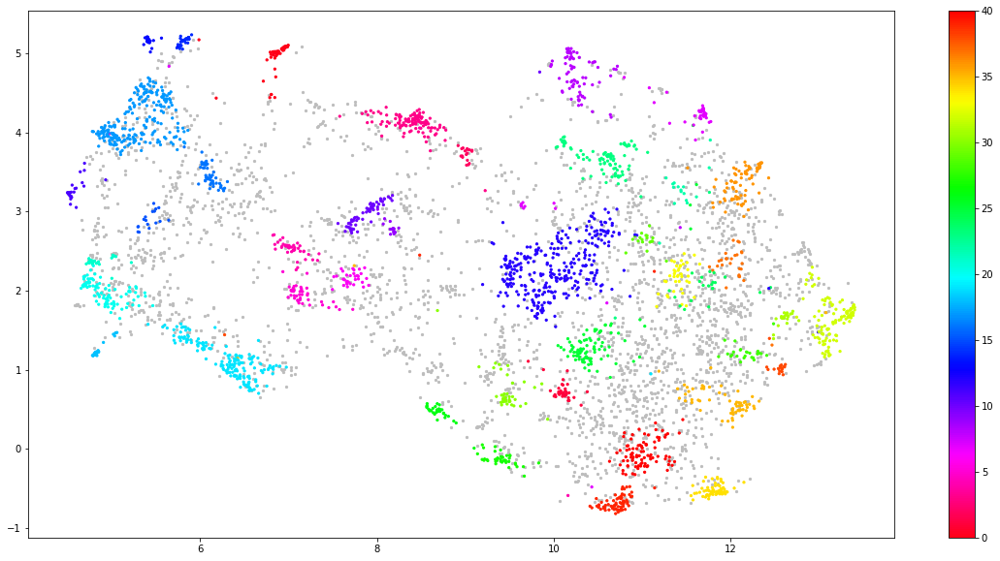

In [159]:
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=5)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=5, cmap='hsv_r')
plt.colorbar()

## Topic modelling

We'll present our texts as bag of words by preprocessing them in several steps:
1. Tokenize text to words
2. Get normal form of each word (lemmatize)

Then we'll glue up texts from the same clusters (our topics) and present each topic as long text of normalized words.

We'll build tf-idf vectors for topics and sort most important word from each topic

In [160]:
# https://ru.stackoverflow.com/questions/995616/%D0%9A%D0%B0%D0%BA-%D1%81%D0%B4%D0%B5%D0%BB%D0%B0%D1%82%D1%8C-tf-idf-%D0%B4%D0%BB%D1%8F-%D1%80%D1%83%D1%81%D1%81%D0%BA%D0%B8%D1%85-%D1%82%D0%B5%D0%BA%D1%81%D1%82%D0%BE%D0%B2

morph = pymorphy2.MorphAnalyzer()
def text_preprocessing(text):
    words = word_tokenize(text)
    words_normalized = [morph.parse(word)[0].normal_form for word in words]
    return " ".join(words_normalized)

In [161]:
docs_df = pd.DataFrame(data_df_no_empty_messages["text"].apply(text_preprocessing).values, columns=["Doc"])
docs_df['Topic'] = cluster.labels_
docs_df['Doc_ID'] = range(len(docs_df))
docs_per_topic = docs_df.groupby(['Topic'], as_index = False).agg({'Doc': ' '.join})

In [163]:
url_stopwords_ru = "https://raw.githubusercontent.com/stopwords-iso/stopwords-ru/master/stopwords-ru.txt"

def get_text(url, encoding='utf-8', to_lower=True):
    url = str(url)
    if url.startswith('http'):
        r = requests.get(url)
        if not r.ok:
            r.raise_for_status()
        return r.text.lower() if to_lower else r.text
    elif os.path.exists(url):
        with open(url, encoding=encoding) as f:
            return f.read().lower() if to_lower else f.read()
    else:
        raise Exception('parameter [url] can be either URL or a filename')

stopwords = get_text(url_stopwords_ru).splitlines()

vectorizer = TfidfVectorizer(stop_words=stopwords, smooth_idf = True, max_df = 0.85)
tf_idf = vectorizer.fit_transform(docs_per_topic.Doc.values).todense().getA()


C:\ProgramData\Anaconda3\envs\text_clusterisation_code\lib\site-packages\sklearn\feature_extraction\text.py:404: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['хотел'] not in stop_words.
  warnings.warn(


In [170]:
def extract_top_n_words_per_topic(tf_idf, vectorizer, docs_per_topic, n=20):
    words = vectorizer.get_feature_names_out()
    labels = list(docs_per_topic.Topic)
    # tf_idf_transposed = tf_idf.T
    indices = tf_idf.argsort()[:, -n:]
    print(tf_idf.shape)
    top_n_words = {label: [(words[j], tf_idf[i][j]) for j in indices[i]][::-1] for i, label in enumerate(labels)}
    return top_n_words

def extract_topic_sizes(df):
    topic_sizes = (df.groupby(['Topic'])
                     .Doc
                     .count()
                     .reset_index()
                     .rename({"Topic": "Topic", "Doc": "Size"}, axis='columns')
                     .sort_values("Size", ascending=False))
    return topic_sizes

top_n_words = extract_top_n_words_per_topic(tf_idf, vectorizer, docs_per_topic, n=20)
topic_sizes = extract_topic_sizes(docs_df); topic_sizes.head(10)

(42, 35015)


,Topic,Size
0,-1,2728
13,12,306
18,17,229
20,19,168
4,3,125
33,32,108
24,23,94
41,40,91
26,25,89
21,20,84


In [165]:
top_n_words[12][:10]

[('родитель', 0.2843334970469443),
 ('взрослый', 0.2090687478286355),
 ('школа', 0.20561299241318368),
 ('учиться', 0.13957412901413854),
 ('бояться', 0.13825739194796743),
 ('возраст', 0.12590180744749724),
 ('мама', 0.12495041083325942),
 ('экзамен', 0.10995725812026516),
 ('вуз', 0.10707569124563178),
 ('семья', 0.10498304433938642)]

In [166]:
top_n_words[17][:10]

[('японский', 0.35478434964839706),
 ('аниме', 0.288194925215136),
 ('манга', 0.26074178261403436),
 ('япония', 0.24061614051930855),
 ('no', 0.17999884174553998),
 ('девушка', 0.10528639340683216),
 ('твиттер', 0.10020473215829719),
 ('сато', 0.09421257097999407),
 ('пользователь', 0.08583492330203155),
 ('персонаж', 0.08272438409357906)]

In [167]:
top_n_words[19][:10]

[('играть', 0.36795019612983343),
 ('игрок', 0.22793645003921306),
 ('видеоигра', 0.1447231930730024),
 ('персонаж', 0.1363470269922733),
 ('игровой', 0.1198473950112406),
 ('босс', 0.11792529032980544),
 ('пк', 0.10407800093081421),
 ('геймер', 0.10207655353011777),
 ('сингл', 0.09889834464799063),
 ('поиграть', 0.0976870500168056)]

In [168]:
top_n_words[3][:10]

[('художник', 0.4719399164680359),
 ('рисовать', 0.406878622283104),
 ('заказ', 0.1526409036939115),
 ('арт', 0.15091728149196282),
 ('искусство', 0.14802027836564752),
 ('изображение', 0.1458695120339241),
 ('нарисовать', 0.13291616832833655),
 ('рисование', 0.12678489577326502),
 ('заказчик', 0.10898904257074578),
 ('рисунок', 0.10560671267536444)]

In [169]:
top_n_words[32][:10]

[('врач', 0.31208075807266383),
 ('расстройство', 0.1955745392553293),
 ('диагноз', 0.18211285880694905),
 ('лекарство', 0.15928786075366097),
 ('терапия', 0.14804340030600704),
 ('симптом', 0.1349139672352375),
 ('таблетка', 0.1303615724371746),
 ('терапевт', 0.12597630722715952),
 ('состояние', 0.11111182358502923),
 ('лечение', 0.10363038021420493)]

In [171]:
top_n_words[23][:10]

[('деньга', 0.3159211060772226),
 ('рабочий', 0.28398815039064707),
 ('бедный', 0.1735291576962645),
 ('зарплата', 0.15655531492452443),
 ('неделя', 0.1318177478097551),
 ('купить', 0.12077656970636715),
 ('сотрудник', 0.10447871743897227),
 ('богатый', 0.10300545777608615),
 ('доход', 0.10179910731057558),
 ('работник', 0.10109114355268037)]

In [172]:
top_n_words[40][:10]

[('общение', 0.39675034914939),
 ('собеседник', 0.24081917834928823),
 ('общаться', 0.20158890841866775),
 ('разговор', 0.18950451124799494),
 ('диалог', 0.1497243925725538),
 ('тема', 0.10979820229931922),
 ('чувство', 0.10398588168687027),
 ('связь', 0.10378145323609346),
 ('знакомство', 0.0926227609035724),
 ('слушать', 0.08800762250234981)]

In [173]:
top_n_words[25][:10]

[('ненавидеть', 0.5548505828690143),
 ('ненависть', 0.20456330464677536),
 ('чувство', 0.13729366498401932),
 ('прощать', 0.12312294246474631),
 ('зависть', 0.09848978746745335),
 ('желание', 0.07971773257514615),
 ('плохо', 0.07792343147741637),
 ('брюссельский', 0.07099012136461795),
 ('завидовать', 0.06372868600835217),
 ('вызывать', 0.06080554332811116)]

In [174]:
top_n_words[20][:10]

[('bioware', 0.246786998107161),
 ('игрок', 0.19236017590427873),
 ('разработчик', 0.18361548724355103),
 ('ea', 0.1673896844953568),
 ('age', 0.16565018549245955),
 ('студия', 0.15860511823408008),
 ('июнь', 0.1523343602106624),
 ('dragon', 0.1479658918132837),
 ('the', 0.14535283566939136),
 ('мск', 0.13684145758072744)]

## Visualization of embeddings and topics keywords

We'll attach to each point of our dataset (to text) set of keywords related to its cluster for better visualization

In [195]:
top_words_dict = {}
for topic in topic_sizes["Topic"].values:
    if topic == -1:
        top_words_dict[topic] = ""
    top_words = "<br>".join([f"{word}, {round(tfidf,3)}" for word, tfidf in top_n_words[topic][:10]])
    top_words_dict[topic] = top_words

In [216]:
def get_description(row):
    wrapped_text = textwrap.wrap(row["data_text"], width = 100)
    text_processed = "<br>".join(wrapped_text)
    description = f"{top_words_dict[row['labels']]}<br>{text_processed}"
    return description
result['description'] = result.apply(get_description, axis=1)

In [217]:
fig = go.Figure(data=go.Scatter(x=result[result["labels"] != -1]['x'],
                                y=result[result["labels"] != -1]['y'],
                                mode='markers',
                                marker=dict(
                                    size=2,
                                    color=result[result["labels"] != -1]['labels'],  #set color equal to a variable
                                    colorscale='Viridis',  # one of plotly colorscales
                                    showscale=True
                                ),
                                text=result[result["labels"] != -1]['description']))  # hover text goes here
fig.add_trace(go.Scatter(x=result[result["labels"] == -1]['x'],
                         y=result[result["labels"] == -1]['y'],
                         mode='markers',
                         marker=dict(
                             size=1,
                             color='#BDBDBD',
                         )))
fig.update_layout(title='Embeddings with topics')
fig.show()

In [218]:
fig.write_html("hikki_embeddings_topics.html")
